In [5]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx

Note: you may need to restart the kernel to use updated packages.


In [6]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [7]:
a_zwickau_text = thesisDataReader.read_a_zwickau()
b_london_text = thesisDataReader.read_b_london()

In [8]:
a_zwickau_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(a_zwickau_text))
b_london_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(b_london_text))

In [9]:
def get_features(corpus):
    vectorizer = TfidfVectorizer()
    sparse_matrix = vectorizer.fit_transform(corpus)
    doc_term_matrix = sparse_matrix.todense()
    df = pd.DataFrame(doc_term_matrix, columns=vectorizer.get_feature_names())
    return df

In [10]:
a_zwickau_df = get_features(a_zwickau_corpus)
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_features(b_london_corpus)
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [11]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [12]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [46] value: 0.07638093604832838
index: [79] value: 0.08115430797444886
index: [19] value: 0.08284583693793095
index: [49] value: 0.11636780858345838
index: [321] value: 0.19251964362248705
index: [0] value: 1.0000000000000002
average: 0.00899313942681251
0 similarities: 277

___ max similariry for paragraph: 1 ___
index: [280] value: 0.1120735320732039
index: [283] value: 0.11550437196423026
index: [185] value: 0.1158910638256373
index: [303] value: 0.12100042083806564
index: [289] value: 0.12884764283528718
index: [1] value: 1.0000000000000007
average: 0.04521175789686829
0 similarities: 4

___ max similariry for paragraph: 2 ___
index: [184] value: 0.06814841839997264
index: [319] value: 0.07511506543390974
index: [182] value: 0.08671430154240134
index: [212] value: 0.08709358706261654
index: [211] value: 0.0930868689658132
index: [2] value: 1.0000000000000002
average: 0.03096538681902107
0 similarities: 5

___ max similariry for paragra

index: [38] value: 0.13826259990562137
index: [230] value: 1.0
average: 0.054103416628923644
0 similarities: 3

___ max similariry for paragraph: 231 ___
index: [74] value: 0.15472999399959486
index: [90] value: 0.15628274350466242
index: [224] value: 0.20585401138390072
index: [137] value: 0.28287571669204503
index: [225] value: 0.48498643763846894
index: [231] value: 1.0
average: 0.05341932236647531
0 similarities: 3

___ max similariry for paragraph: 232 ___
index: [134] value: 0.08526172520963086
index: [236] value: 0.10908987930435904
index: [83] value: 0.11060590362981192
index: [234] value: 0.11278807124897218
index: [226] value: 0.15509203623932846
index: [232] value: 1.0
average: 0.040209355203097485
0 similarities: 3

___ max similariry for paragraph: 233 ___
index: [167] value: 0.1074568494710015
index: [145] value: 0.12008733072104483
index: [117] value: 0.1255451964604167
index: [299] value: 0.12844882022172555
index: [166] value: 0.1296442224685536
index: [233] value: 1.0

In [13]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [272] value: 0.08314473595430591
index: [266] value: 0.08502538038037527
index: [209] value: 0.08779260399471141
index: [19] value: 0.09227046857140189
index: [317] value: 0.10154895530417724
index: [0] value: 1.0000000000000002
average: 0.01727950948484574
0 similarities: 71

___ max similariry for paragraph: 1 ___
index: [272] value: 0.10382324227916252
index: [295] value: 0.10424719543688482
index: [313] value: 0.10974869265824062
index: [275] value: 0.11550128248960749
index: [281] value: 0.12160769249281095
index: [1] value: 1.0000000000000002
average: 0.047654310670229724
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [293] value: 0.07138533073922008
index: [154] value: 0.07254721250834587
index: [26] value: 0.07256070572349452
index: [220] value: 0.07914292894390643
index: [311] value: 0.0927215591275178
index: [2] value: 1.0000000000000002
average: 0.035741492700767916
0 similarities: 1

___ max similariry for


___ max similariry for paragraph: 230 ___
index: [209] value: 0.14131879432887615
index: [292] value: 0.15271112284855787
index: [137] value: 0.16768346734099568
index: [231] value: 0.17122605928150814
index: [80] value: 0.2457219670400435
index: [230] value: 1.0000000000000002
average: 0.055318430845283324
0 similarities: None

___ max similariry for paragraph: 231 ___
index: [232] value: 0.1970316938877332
index: [83] value: 0.1973835816532675
index: [74] value: 0.1983199882611104
index: [132] value: 0.19955278617906985
index: [197] value: 0.20025109968367086
index: [231] value: 0.9999999999999994
average: 0.10187465436735493
0 similarities: None

___ max similariry for paragraph: 232 ___
index: [138] value: 0.16972298552678608
index: [129] value: 0.1746637878466494
index: [289] value: 0.1785496540312528
index: [231] value: 0.1970316938877332
index: [85] value: 0.26529130834556086
index: [232] value: 1.0000000000000004
average: 0.07579791970207941
0 similarities: None

___ max simil

In [14]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [15]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


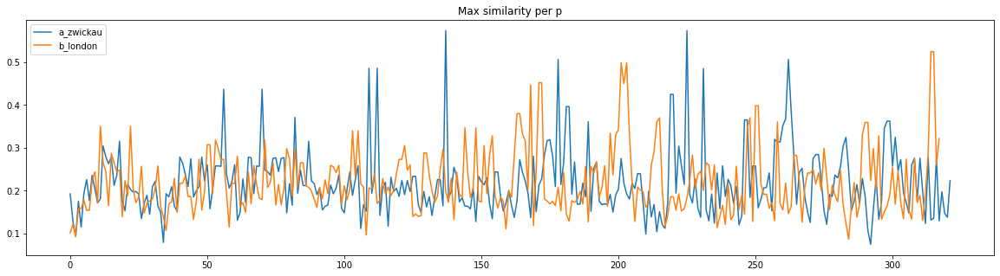

In [16]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [17]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [44]:
for i in [10]:
    temp_corpus = [a_zwickau_corpus[i]] + b_london_corpus
    df_features = get_features(temp_corpus)
    temp_similarities = cosine_similarity(df_features, df_features)
    display(temp_similarities[0])

array([1.        , 0.        , 0.04498889, 0.04579061, 0.05113117,
       0.04686504, 0.07466432, 0.04843672, 0.06188728, 0.06303644,
       0.13002659, 0.45607138, 0.09737847, 0.05449408, 0.08211536,
       0.06200962, 0.02607721, 0.05034767, 0.04787904, 0.07685455,
       0.02695189, 0.09044741, 0.06087093, 0.02319778, 0.07054228,
       0.0281763 , 0.07585712, 0.09192679, 0.11886901, 0.06344613,
       0.07721368, 0.06519187, 0.08614919, 0.0504298 , 0.04395681,
       0.0828023 , 0.04700487, 0.05540744, 0.08919698, 0.08765267,
       0.05963103, 0.0549643 , 0.06342508, 0.08045965, 0.06384794,
       0.04212066, 0.09877244, 0.14663028, 0.04461494, 0.02954547,
       0.03423015, 0.06645012, 0.08063118, 0.08006273, 0.0726604 ,
       0.07402482, 0.09055346, 0.05692712, 0.01835841, 0.01759255,
       0.06681938, 0.06689368, 0.02976053, 0.0272981 , 0.02275156,
       0.03810187, 0.0599507 , 0.05118436, 0.07455632, 0.03743747,
       0.062624  , 0.07550265, 0.0844067 , 0.05720079, 0.06460

In [18]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)


In [19]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [21] value: 0.06626392277601388
index: [308] value: 0.06801053531668791
index: [12] value: 0.06841839527252638
index: [9] value: 0.12447304672102247
index: [20] value: 0.15304356523575346
index: [0] value: 1.0000000000000002
average: 0.009170831826740498
0 similarities: 270

___ max similariry for paragraph: 1 ___
index: [273] value: 0.11241834952217088
index: [276] value: 0.11349415018805682
index: [296] value: 0.1157658743883011
index: [282] value: 0.12691012357664977
index: [2] value: 0.7669884394931847
index: [0] value: 1.0000000000000004
average: 0.05016987793847056
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [219] value: 0.0688843968007109
index: [155] value: 0.07081005698871709
index: [221] value: 0.07830275652063139
index: [312] value: 0.08821342944218058
index: [3] value: 0.8961951060069312
index: [0] value: 1.0
average: 0.0359189098316106
0 similarities: 1

___ max similariry for paragraph: 3 ___
index: [

0 similarities: 2

___ max similariry for paragraph: 224 ___
index: [86] value: 0.18214760528361135
index: [19] value: 0.18633032124013008
index: [154] value: 0.1865584336440521
index: [145] value: 0.20666814856734594
index: [232] value: 0.3469445585424799
index: [0] value: 1.0000000000000002
average: 0.08426956944169947
0 similarities: None

___ max similariry for paragraph: 225 ___
index: [210] value: 0.18692477515126188
index: [233] value: 0.19318440265623663
index: [245] value: 0.2226765085668643
index: [153] value: 0.2845759187925795
index: [133] value: 0.4895650568144054
index: [0] value: 1.0
average: 0.053722853732561235
0 similarities: 3

___ max similariry for paragraph: 226 ___
index: [234] value: 0.16752693311293665
index: [290] value: 0.16941300681886928
index: [232] value: 0.16989525394581853
index: [236] value: 0.18508079308035863
index: [233] value: 0.3312977081473526
index: [0] value: 1.0000000000000002
average: 0.06641981724285992
0 similarities: None

___ max similari

In [20]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [281] value: 0.08469768762925065
index: [100] value: 0.0870462686537064
index: [194] value: 0.08831240193550585
index: [139] value: 0.09448501688192376
index: [219] value: 0.1275678920203903
index: [0] value: 1.0000000000000002
average: 0.017422072434920628
0 similarities: 88

___ max similariry for paragraph: 1 ___
index: [304] value: 0.11249267333880072
index: [186] value: 0.1142742141774798
index: [284] value: 0.12109671073612453
index: [290] value: 0.12625707910394873
index: [2] value: 0.7610966485868048
index: [0] value: 1.0
average: 0.04721730043625707
0 similarities: 4

___ max similariry for paragraph: 2 ___
index: [320] value: 0.07676336778672099
index: [213] value: 0.0865039728229971
index: [183] value: 0.09281708942341224
index: [212] value: 0.09518905274669003
index: [3] value: 0.8972675640760482
index: [0] value: 1.0
average: 0.037816981321298876
0 similarities: 5

___ max similariry for paragraph: 3 ___
index: [8] value: 0.11

0 similarities: None

___ max similariry for paragraph: 73 ___
index: [298] value: 0.18198307342149286
index: [24] value: 0.1890126109003285
index: [300] value: 0.20225156982692105
index: [64] value: 0.21188459612491758
index: [74] value: 0.6573623883361719
index: [0] value: 1.0
average: 0.0890597113731341
0 similarities: 1

___ max similariry for paragraph: 74 ___
index: [232] value: 0.18977654792175794
index: [298] value: 0.19306611042867017
index: [300] value: 0.21492633940810943
index: [78] value: 0.3400001386423689
index: [75] value: 0.6215845038690294
index: [0] value: 1.0
average: 0.09183435533510584
0 similarities: 1

___ max similariry for paragraph: 75 ___
index: [64] value: 0.1557807803297801
index: [85] value: 0.1558151217471056
index: [298] value: 0.156292463238002
index: [53] value: 0.20718557493155293
index: [76] value: 0.23530357026071375
index: [0] value: 1.0000000000000002
average: 0.0691545278902182
0 similarities: 2

___ max similariry for paragraph: 76 ___
index: [

index: [174] value: 0.3355480717643175
index: [176] value: 0.3719388324831551
index: [175] value: 0.596753594930396
index: [0] value: 1.0000000000000002
average: 0.08611722130954653
0 similarities: 2

___ max similariry for paragraph: 165 ___
index: [183] value: 0.22287461170301448
index: [262] value: 0.24994010764761607
index: [174] value: 0.264669082789967
index: [175] value: 0.2871111474307924
index: [176] value: 0.615641899319366
index: [0] value: 1.0
average: 0.08908213082229752
0 similarities: 1

___ max similariry for paragraph: 166 ___
index: [260] value: 0.21857096639854934
index: [175] value: 0.2670492811560543
index: [170] value: 0.272499348272019
index: [174] value: 0.3117955115597846
index: [177] value: 0.7395711230288643
index: [0] value: 1.0000000000000004
average: 0.07905243850132088
0 similarities: 3

___ max similariry for paragraph: 167 ___
index: [124] value: 0.1790292041457998
index: [266] value: 0.1864271392380885
index: [264] value: 0.19730518518198403
index: [18

index: [279] value: 0.745379778933779
index: [0] value: 0.9999999999999998
average: 0.05120426341260018
0 similarities: 5

___ max similariry for paragraph: 270 ___
index: [60] value: 0.10209769419087257
index: [284] value: 0.12579927389771378
index: [291] value: 0.14443334982166678
index: [279] value: 0.28243657531124444
index: [280] value: 0.42101407658563755
index: [0] value: 0.9999999999999999
average: 0.03015540054557688
0 similarities: 14

___ max similariry for paragraph: 271 ___
index: [290] value: 0.16241672248904038
index: [281] value: 0.17538795244349814
index: [282] value: 0.1962215553780577
index: [284] value: 0.2513268068293795
index: [280] value: 0.8387408565130304
index: [0] value: 0.9999999999999999
average: 0.07157062484936953
0 similarities: 1

___ max similariry for paragraph: 272 ___
index: [6] value: 0.1911839559024503
index: [89] value: 0.19641988355121817
index: [282] value: 0.21085208461042226
index: [284] value: 0.22688060322435946
index: [281] value: 0.853749

In [21]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

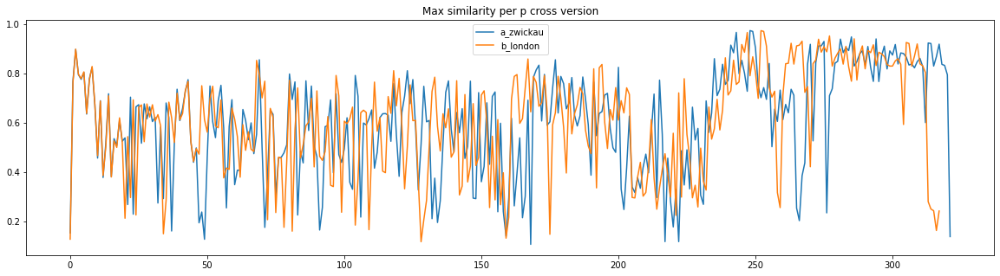

In [22]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [23]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    return G

In [24]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [25]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

In [26]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

1
1


In [27]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

[(297, 54), (299, 51), (281, 35), (283, 32), (70, 32), (169, 26), (88, 25), (87, 25), (280, 24), (152, 22), (289, 20), (184, 19), (59, 19), (182, 18), (303, 17), (76, 16), (301, 16), (201, 15), (21, 14), (30, 14), (225, 14), (173, 14), (121, 13), (56, 13), (105, 13), (313, 13), (167, 13), (290, 13), (211, 12), (9, 12), (104, 12), (236, 12), (192, 12), (262, 12), (73, 11), (63, 11), (101, 11), (84, 11), (74, 11), (219, 11), (255, 11), (123, 10), (300, 10), (42, 10), (58, 10), (224, 10), (149, 10), (66, 10), (187, 10), (36, 10), (54, 10), (126, 10), (86, 10), (257, 10), (114, 10), (226, 10), (279, 9), (23, 9), (200, 9), (64, 9), (78, 9), (35, 9), (72, 9), (316, 9), (77, 9), (109, 9), (98, 9), (175, 9), (46, 8), (185, 8), (212, 8), (6, 8), (16, 8), (11, 8), (282, 8), (24, 8), (43, 8), (112, 8), (147, 8), (274, 8), (125, 8), (71, 8), (60, 8), (166, 8), (145, 8), (231, 8), (240, 8), (107, 8), (115, 8), (318, 8), (160, 8), (176, 8), (174, 8), (264, 8), (263, 8), (178, 8), (227, 8), (19, 7), 

In [28]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(289, 45), (291, 35), (55, 31), (313, 30), (162, 28), (275, 25), (192, 23), (273, 22), (205, 22), (80, 22), (272, 19), (281, 19), (165, 17), (293, 16), (85, 16), (144, 16), (53, 16), (203, 16), (305, 15), (148, 15), (197, 15), (209, 14), (317, 14), (31, 14), (59, 14), (74, 14), (282, 14), (153, 14), (164, 14), (295, 13), (204, 13), (42, 13), (51, 13), (235, 13), (61, 13), (92, 12), (46, 12), (98, 12), (97, 12), (73, 12), (232, 12), (233, 12), (163, 12), (202, 12), (266, 11), (82, 11), (161, 11), (71, 11), (147, 11), (83, 11), (231, 11), (183, 11), (167, 11), (172, 11), (255, 10), (212, 10), (106, 10), (174, 10), (178, 10), (158, 10), (121, 10), (308, 10), (200, 10), (201, 10), (13, 9), (79, 9), (76, 9), (88, 9), (32, 9), (38, 9), (117, 9), (247, 9), (96, 9), (91, 9), (118, 9), (134, 9), (292, 9), (240, 9), (271, 8), (151, 8), (196, 8), (9, 8), (100, 8), (185, 8), (191, 8), (109, 8), (56, 8), (157, 8), (102, 8), (207, 8), (129, 8), (227, 8), (261, 8), (176, 8), (199, 8), (208, 8), (188

In [29]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

56
[(297, 54), (299, 51), (281, 35), (283, 32), (70, 32), (169, 26), (88, 25), (87, 25), (280, 24), (152, 22), (289, 20), (184, 19), (59, 19), (182, 18), (303, 17), (76, 16), (301, 16), (201, 15), (21, 14), (30, 14), (225, 14), (173, 14), (121, 13), (56, 13), (105, 13), (313, 13), (167, 13), (290, 13), (211, 12), (9, 12), (104, 12), (236, 12), (192, 12), (262, 12), (73, 11), (63, 11), (101, 11), (84, 11), (74, 11), (219, 11), (255, 11), (123, 10), (300, 10), (42, 10), (58, 10), (224, 10), (149, 10), (66, 10), (187, 10), (36, 10), (54, 10), (126, 10), (86, 10), (257, 10), (114, 10), (226, 10)]


In [30]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

64
[(289, 45), (291, 35), (55, 31), (313, 30), (162, 28), (275, 25), (192, 23), (273, 22), (205, 22), (80, 22), (272, 19), (281, 19), (165, 17), (293, 16), (85, 16), (144, 16), (53, 16), (203, 16), (305, 15), (148, 15), (197, 15), (209, 14), (317, 14), (31, 14), (59, 14), (74, 14), (282, 14), (153, 14), (164, 14), (295, 13), (204, 13), (42, 13), (51, 13), (235, 13), (61, 13), (92, 12), (46, 12), (98, 12), (97, 12), (73, 12), (232, 12), (233, 12), (163, 12), (202, 12), (266, 11), (82, 11), (161, 11), (71, 11), (147, 11), (83, 11), (231, 11), (183, 11), (167, 11), (172, 11), (255, 10), (212, 10), (106, 10), (174, 10), (178, 10), (158, 10), (121, 10), (308, 10), (200, 10), (201, 10)]


<IPython.core.display.Javascript object>


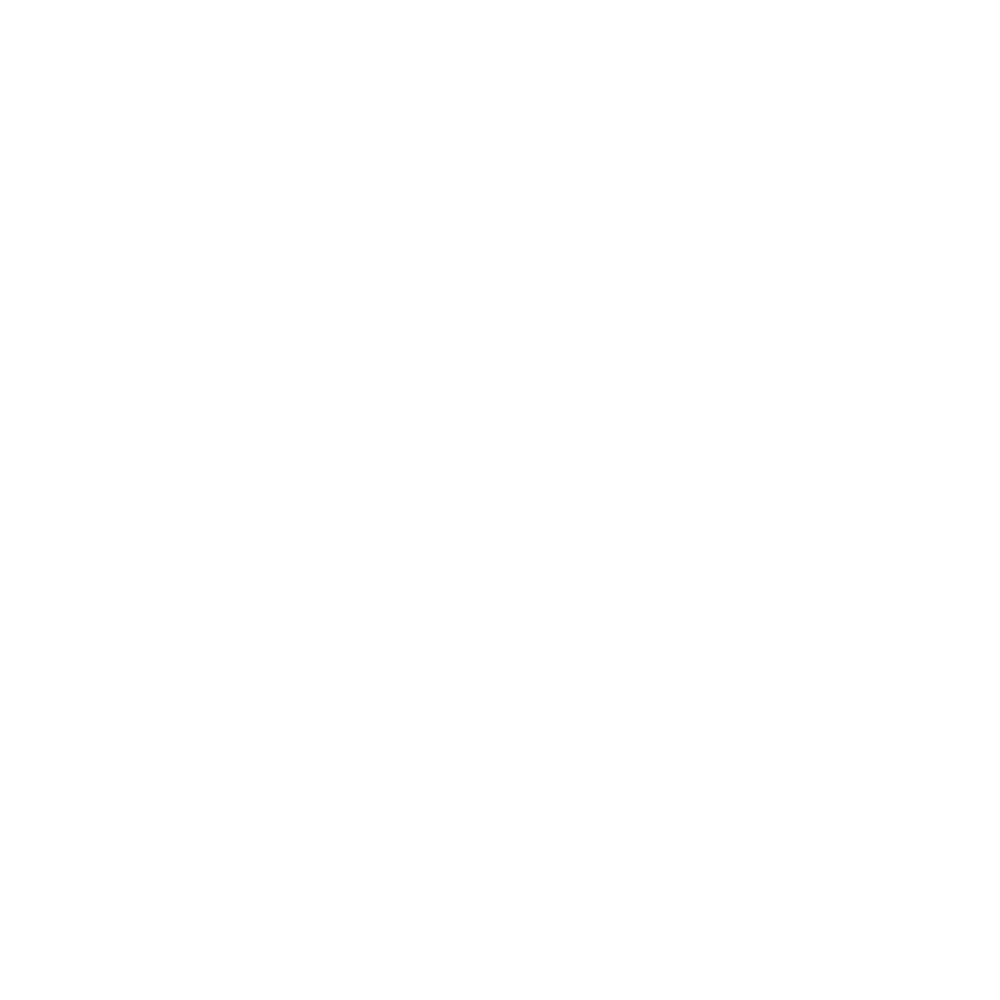

In [31]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


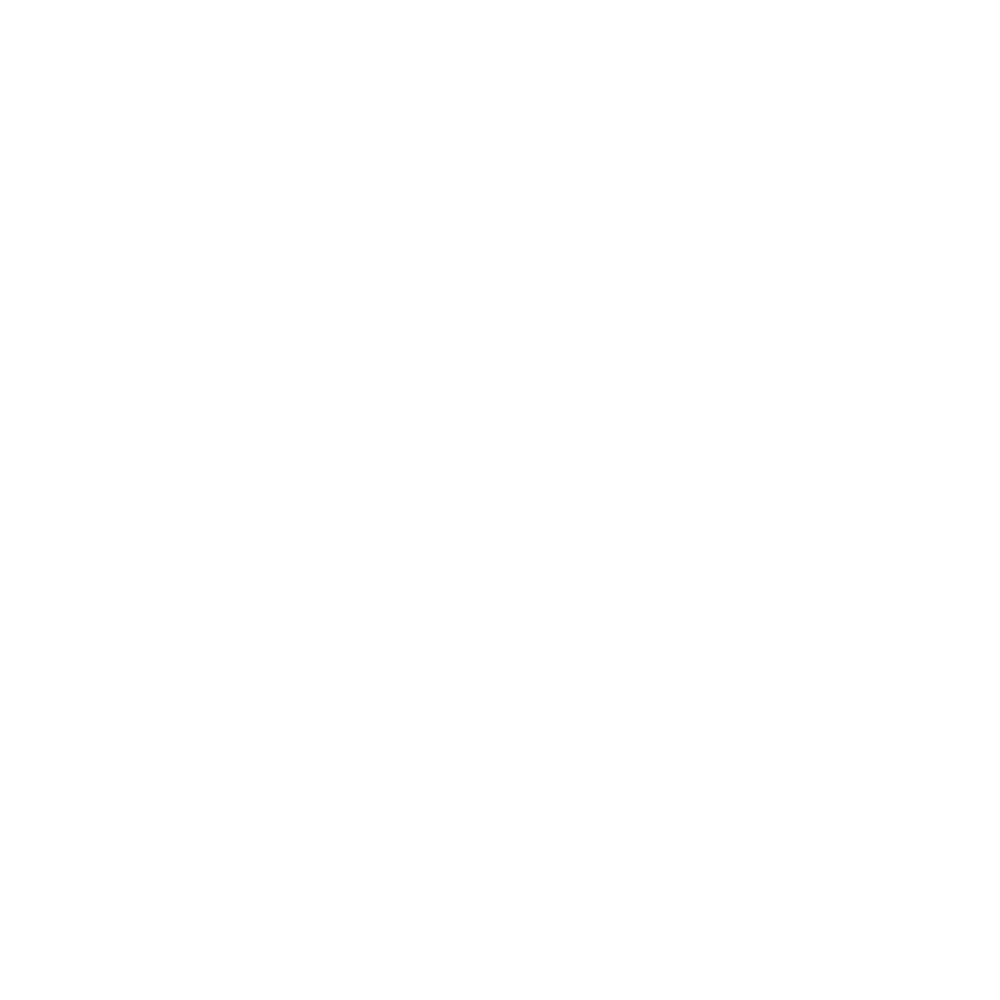

In [32]:
show_G(b_london_G)

In [62]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_similarities)
b_london_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [61]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
b_london_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()